<a href="https://colab.research.google.com/github/maryamhgf/CLIP-Image-Cropping-Analysis/blob/master/CLIP_Classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Imagenet

In [34]:
import os
import numpy as np
from torchvision.datasets import ImageFolder
from torchvision import transforms
from torch.utils.data import DataLoader
from transformers import CLIPProcessor, CLIPModel
import torch
from sklearn.metrics import accuracy_score, f1_score
from tqdm import tqdm

device = "cuda" if torch.cuda.is_available() else "cpu"
device

'cuda'

In [2]:
!kaggle datasets download -d ifigotin/imagenetmini-1000

Dataset URL: https://www.kaggle.com/datasets/ifigotin/imagenetmini-1000
License(s): unknown
100% 3.91G/3.92G [00:42<00:00, 149MB/s]
100% 3.92G/3.92G [00:42<00:00, 99.1MB/s]


In [3]:
!unzip /content/imagenetmini-1000.zip -d /content/imagenetmini-1000

Streaming output truncated to the last 5000 lines.
  inflating: /content/imagenetmini-1000/imagenet-mini/train/n07875152/n07875152_2763.JPEG  
  inflating: /content/imagenetmini-1000/imagenet-mini/train/n07875152/n07875152_3015.JPEG  
  inflating: /content/imagenetmini-1000/imagenet-mini/train/n07875152/n07875152_3378.JPEG  
  inflating: /content/imagenetmini-1000/imagenet-mini/train/n07875152/n07875152_3497.JPEG  
  inflating: /content/imagenetmini-1000/imagenet-mini/train/n07875152/n07875152_3745.JPEG  
  inflating: /content/imagenetmini-1000/imagenet-mini/train/n07875152/n07875152_4157.JPEG  
  inflating: /content/imagenetmini-1000/imagenet-mini/train/n07875152/n07875152_461.JPEG  
  inflating: /content/imagenetmini-1000/imagenet-mini/train/n07875152/n07875152_4704.JPEG  
  inflating: /content/imagenetmini-1000/imagenet-mini/train/n07875152/n07875152_4789.JPEG  
  inflating: /content/imagenetmini-1000/imagenet-mini/train/n07875152/n07875152_4848.JPEG  
  inflating: /content/imagenet

In [5]:
imagenet_classes = dict()
with open('/content/words.txt') as f:
    for line in f.readlines():
        row = line.split('\t')
        key = row[0]
        value = row[-1]
        if value.endswith('\n'): value = value[:-1]
        imagenet_classes[key] = value

available_classes = [x[0].split('/')[-1] for x in os.walk('/content/imagenetmini-1000/imagenet-mini/train')][1:]
available_classes.sort()
class_names = []

for class_name in available_classes:
    class_names.append(imagenet_classes[class_name])

print(len(available_classes))
print(available_classes[:5])
print(len(class_names))
print(class_names[:5])

1000
['n01440764', 'n01443537', 'n01484850', 'n01491361', 'n01494475']
1000
['tench, Tinca tinca', 'goldfish, Carassius auratus', 'great white shark, white shark, man-eater, man-eating shark, Carcharodon carcharias', 'tiger shark, Galeocerdo cuvieri', 'hammerhead, hammerhead shark']


In [32]:
class ImageFolderWithPaths(ImageFolder):
    def __getitem__(self, index):
        original_tuple = super(ImageFolderWithPaths, self).__getitem__(index)
        path = self.imgs[index][0]
        tuple_with_path = original_tuple + (path,)
        return tuple_with_path


class ConditionalRandomCrop:
    def __init__(self, crop_size):
        self.crop_size = crop_size

    def __call__(self, img):
        width, height = img.size

        if width < self.crop_size[0] or height < self.crop_size[1]:
            return img.resize(self.crop_size)
        else:
            return transforms.RandomCrop(self.crop_size)(img)


transform_cropped = transforms.Compose([
    ConditionalRandomCrop((224, 224)),
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(
        mean=[0.485, 0.456, 0.406],
        std=[0.229, 0.224, 0.225]
    )
])

transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(
        mean=[0.485, 0.456, 0.406],
        std=[0.229, 0.224, 0.225]
    )
])

test_dataset_cropped = ImageFolderWithPaths(
    root='/content/imagenetmini-1000/imagenet-mini/val',
    transform=transform_cropped
)

test_dataset = ImageFolderWithPaths(
    root='/content/imagenetmini-1000/imagenet-mini/val',
    transform=transform
)

test_loader_cropped = DataLoader(test_dataset_cropped, batch_size=16, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=16, shuffle=False)

In [7]:
clip_labels = [f"a photo of a {label}" for label in class_names]

In [12]:
model_id = "openai/clip-vit-base-patch32"

processor = CLIPProcessor.from_pretrained(model_id)
model = CLIPModel.from_pretrained(model_id).to(device)

In [9]:
text_inputs  = processor(
    text=clip_labels,
    padding=True,
    images=None,
    return_tensors='pt'
).to(device)

text_inputs ['input_ids'][0][:10]

tensor([49406,   320,  1125,   539,   320,  1149,   634,   267,  1310,  1684],
       device='cuda:0')

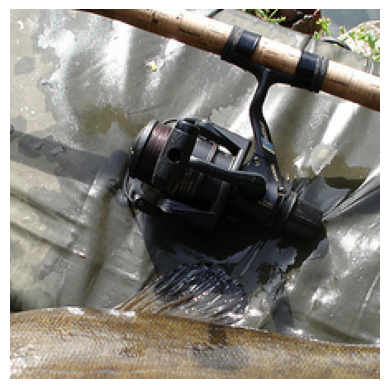

Label: 0
Path: /content/imagenetmini-1000/imagenet-mini/val/n01440764/ILSVRC2012_val_00009111.JPEG


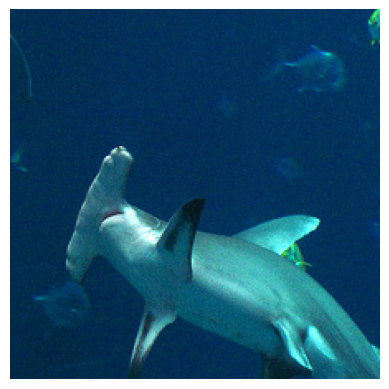

Label: 4
Path: /content/imagenetmini-1000/imagenet-mini/val/n01494475/ILSVRC2012_val_00027160.JPEG


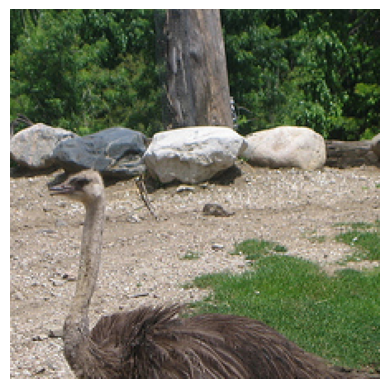

Label: 9
Path: /content/imagenetmini-1000/imagenet-mini/val/n01518878/ILSVRC2012_val_00034316.JPEG


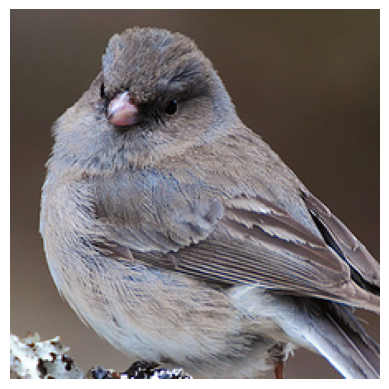

Label: 13
Path: /content/imagenetmini-1000/imagenet-mini/val/n01534433/ILSVRC2012_val_00047333.JPEG


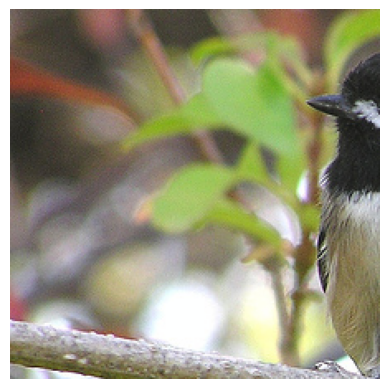

Label: 19
Path: /content/imagenetmini-1000/imagenet-mini/val/n01592084/ILSVRC2012_val_00017017.JPEG


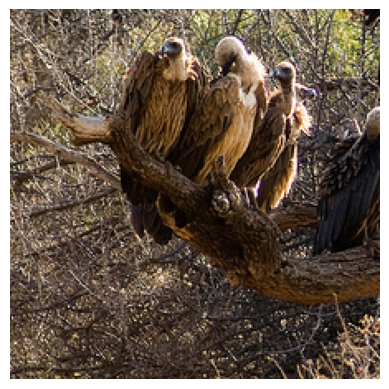

Label: 23
Path: /content/imagenetmini-1000/imagenet-mini/val/n01616318/ILSVRC2012_val_00037259.JPEG


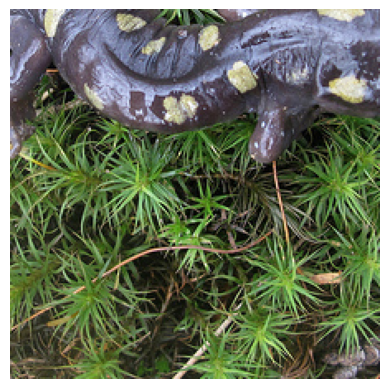

Label: 28
Path: /content/imagenetmini-1000/imagenet-mini/val/n01632458/ILSVRC2012_val_00001131.JPEG


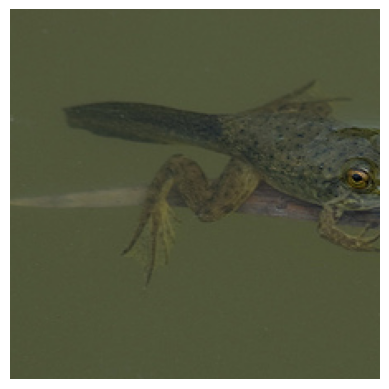

Label: 32
Path: /content/imagenetmini-1000/imagenet-mini/val/n01644900/ILSVRC2012_val_00024102.JPEG


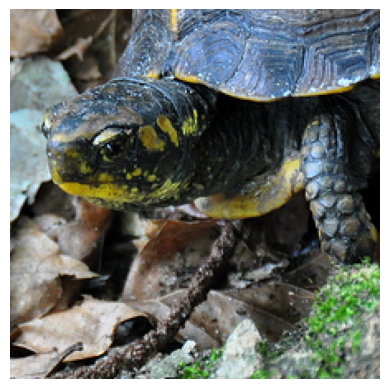

Label: 37
Path: /content/imagenetmini-1000/imagenet-mini/val/n01669191/ILSVRC2012_val_00031467.JPEG


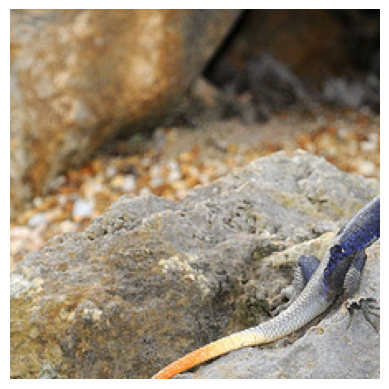

Label: 42
Path: /content/imagenetmini-1000/imagenet-mini/val/n01687978/ILSVRC2012_val_00021582.JPEG


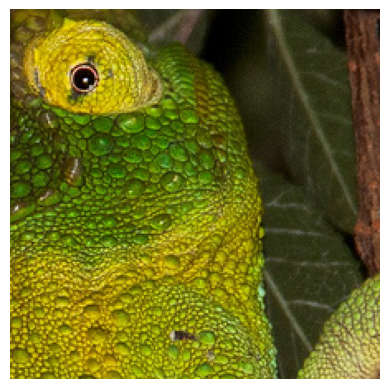

Label: 47
Path: /content/imagenetmini-1000/imagenet-mini/val/n01694178/ILSVRC2012_val_00015831.JPEG


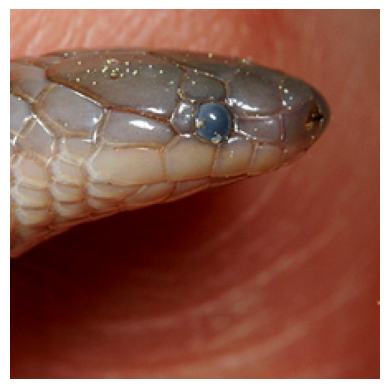

Label: 52
Path: /content/imagenetmini-1000/imagenet-mini/val/n01728572/ILSVRC2012_val_00016737.JPEG


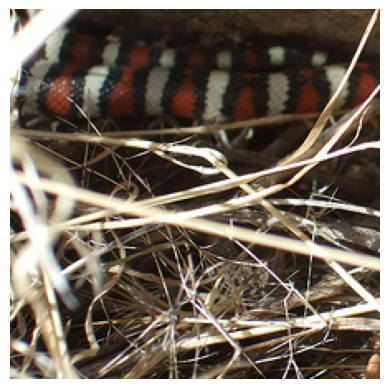

Label: 56
Path: /content/imagenetmini-1000/imagenet-mini/val/n01734418/ILSVRC2012_val_00012578.JPEG


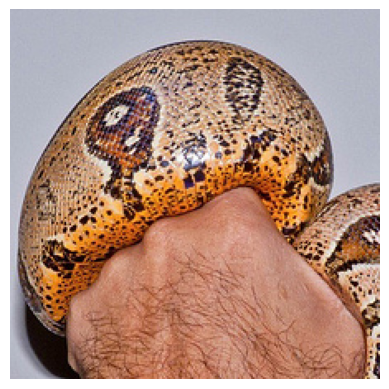

Label: 61
Path: /content/imagenetmini-1000/imagenet-mini/val/n01742172/ILSVRC2012_val_00045042.JPEG


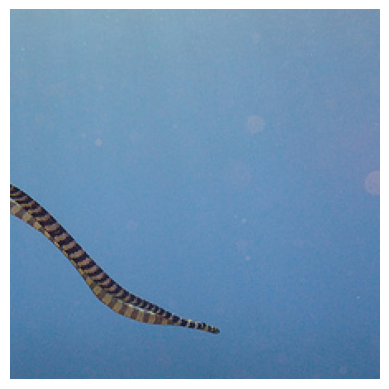

Label: 65
Path: /content/imagenetmini-1000/imagenet-mini/val/n01751748/ILSVRC2012_val_00043075.JPEG


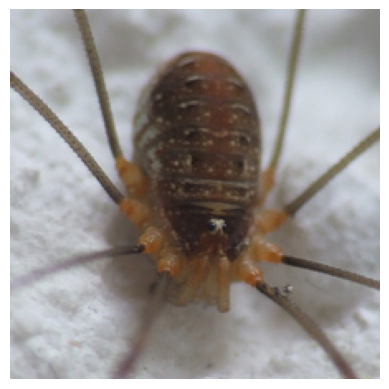

Label: 70
Path: /content/imagenetmini-1000/imagenet-mini/val/n01770081/ILSVRC2012_val_00016507.JPEG


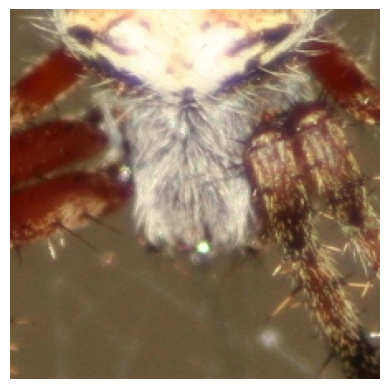

Label: 75
Path: /content/imagenetmini-1000/imagenet-mini/val/n01774384/ILSVRC2012_val_00048068.JPEG


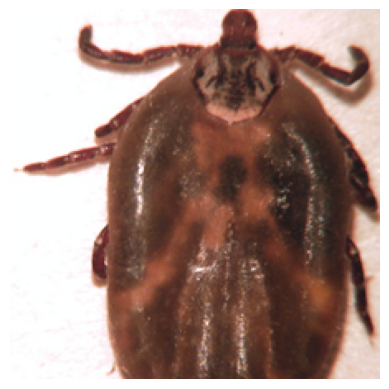

Label: 78
Path: /content/imagenetmini-1000/imagenet-mini/val/n01776313/ILSVRC2012_val_00042899.JPEG


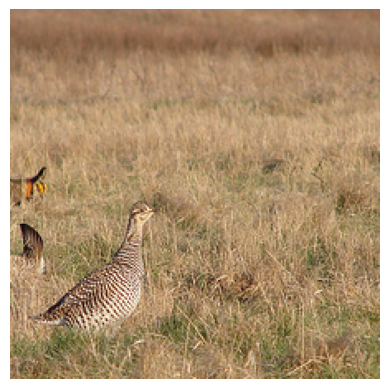

Label: 83
Path: /content/imagenetmini-1000/imagenet-mini/val/n01798484/ILSVRC2012_val_00020239.JPEG


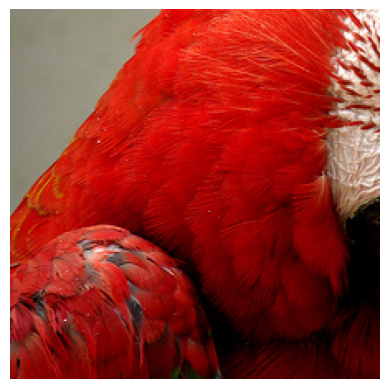

Label: 88
Path: /content/imagenetmini-1000/imagenet-mini/val/n01818515/ILSVRC2012_val_00027656.JPEG


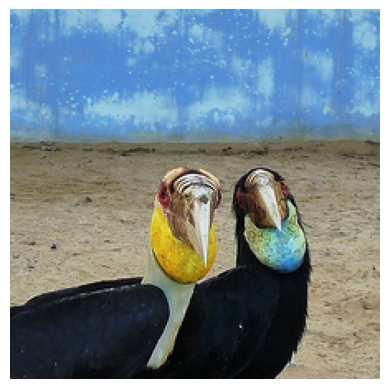

Label: 93
Path: /content/imagenetmini-1000/imagenet-mini/val/n01829413/ILSVRC2012_val_00038476.JPEG


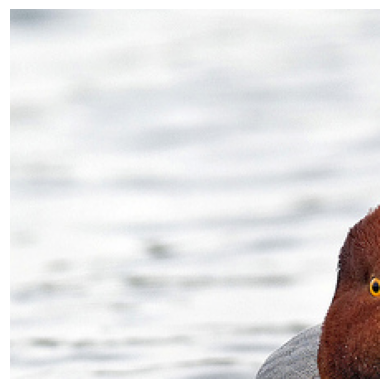

Label: 97
Path: /content/imagenetmini-1000/imagenet-mini/val/n01847000/ILSVRC2012_val_00035054.JPEG


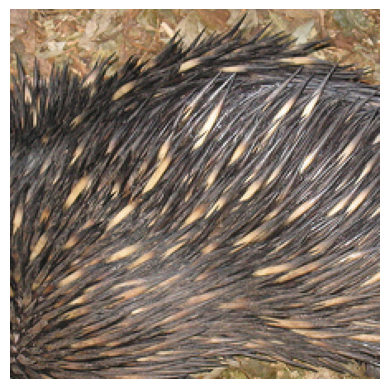

Label: 102
Path: /content/imagenetmini-1000/imagenet-mini/val/n01872401/ILSVRC2012_val_00047972.JPEG


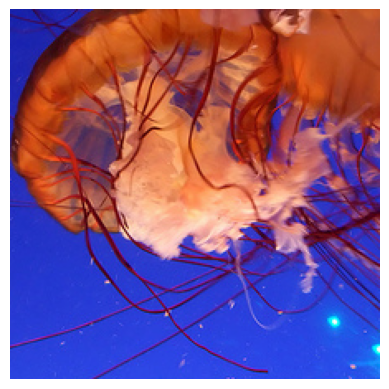

Label: 107
Path: /content/imagenetmini-1000/imagenet-mini/val/n01910747/ILSVRC2012_val_00015443.JPEG


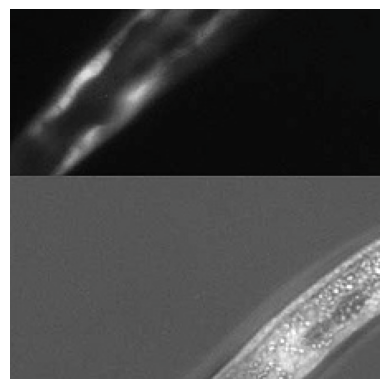

Label: 111
Path: /content/imagenetmini-1000/imagenet-mini/val/n01930112/ILSVRC2012_val_00035048.JPEG


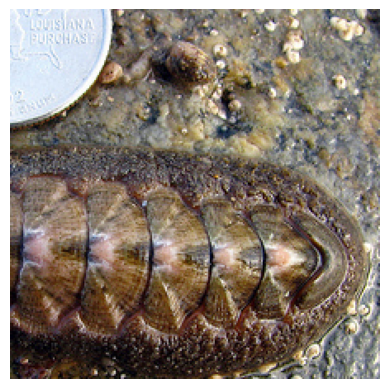

Label: 116
Path: /content/imagenetmini-1000/imagenet-mini/val/n01955084/ILSVRC2012_val_00025056.JPEG


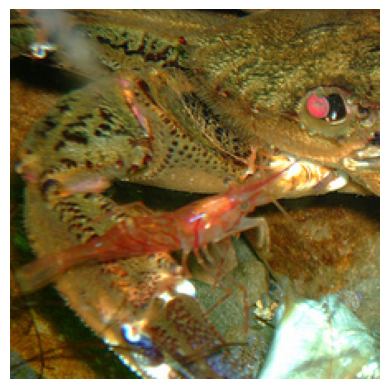

Label: 120
Path: /content/imagenetmini-1000/imagenet-mini/val/n01980166/ILSVRC2012_val_00035169.JPEG


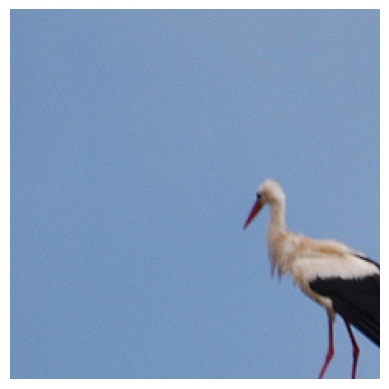

Label: 127
Path: /content/imagenetmini-1000/imagenet-mini/val/n02002556/ILSVRC2012_val_00008287.JPEG


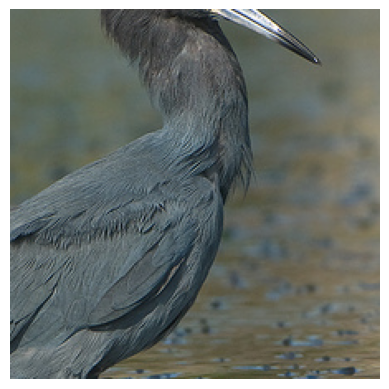

Label: 131
Path: /content/imagenetmini-1000/imagenet-mini/val/n02009229/ILSVRC2012_val_00000794.JPEG


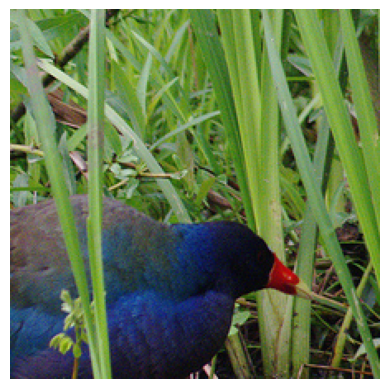

Label: 136
Path: /content/imagenetmini-1000/imagenet-mini/val/n02017213/ILSVRC2012_val_00035085.JPEG


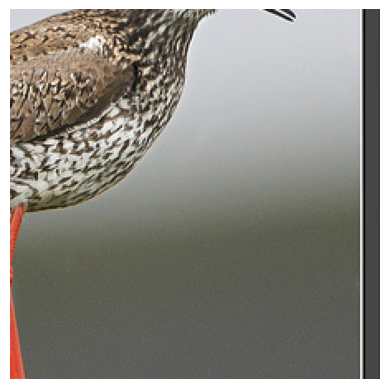

Label: 141
Path: /content/imagenetmini-1000/imagenet-mini/val/n02028035/ILSVRC2012_val_00013808.JPEG


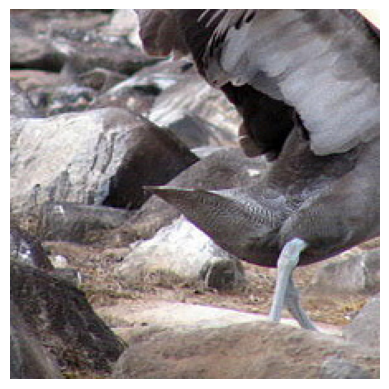

Label: 146
Path: /content/imagenetmini-1000/imagenet-mini/val/n02058221/ILSVRC2012_val_00008056.JPEG


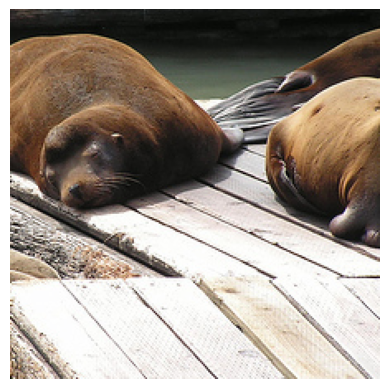

Label: 150
Path: /content/imagenetmini-1000/imagenet-mini/val/n02077923/ILSVRC2012_val_00032540.JPEG


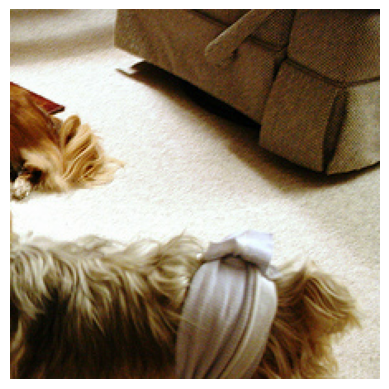

Label: 154
Path: /content/imagenetmini-1000/imagenet-mini/val/n02086079/ILSVRC2012_val_00009250.JPEG


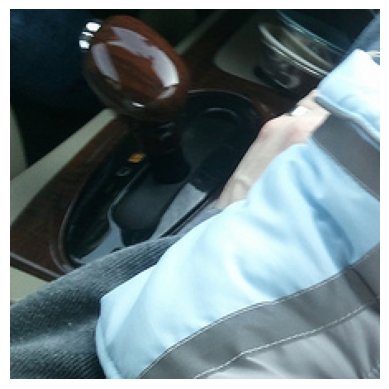

Label: 158
Path: /content/imagenetmini-1000/imagenet-mini/val/n02087046/ILSVRC2012_val_00029090.JPEG


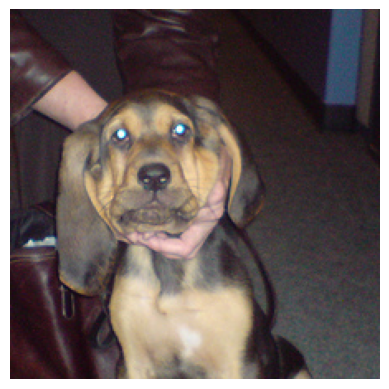

Label: 163
Path: /content/imagenetmini-1000/imagenet-mini/val/n02088466/ILSVRC2012_val_00000909.JPEG


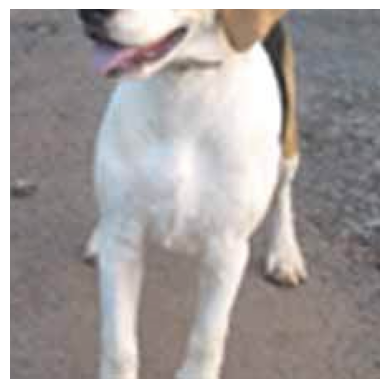

Label: 167
Path: /content/imagenetmini-1000/imagenet-mini/val/n02089973/ILSVRC2012_val_00002246.JPEG


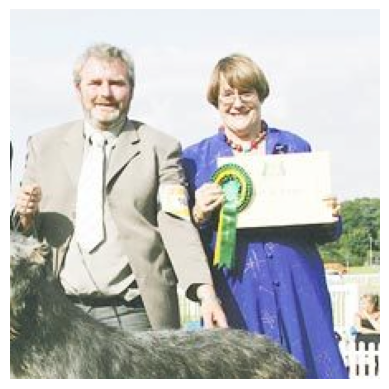

Label: 170
Path: /content/imagenetmini-1000/imagenet-mini/val/n02090721/ILSVRC2012_val_00042158.JPEG


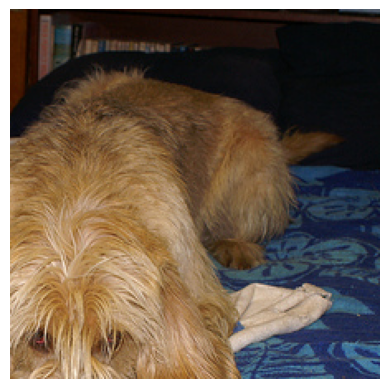

Label: 175
Path: /content/imagenetmini-1000/imagenet-mini/val/n02091635/ILSVRC2012_val_00032793.JPEG


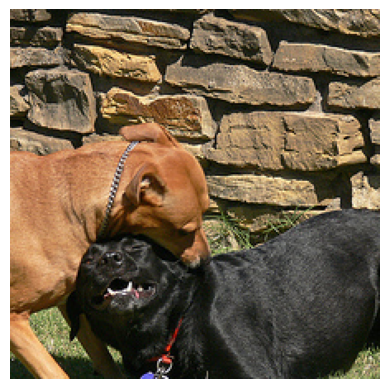

Label: 180
Path: /content/imagenetmini-1000/imagenet-mini/val/n02093428/ILSVRC2012_val_00011381.JPEG


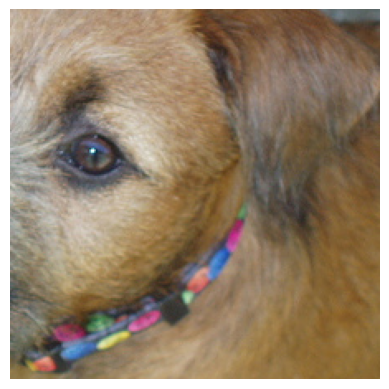

Label: 184
Path: /content/imagenetmini-1000/imagenet-mini/val/n02093991/ILSVRC2012_val_00037891.JPEG


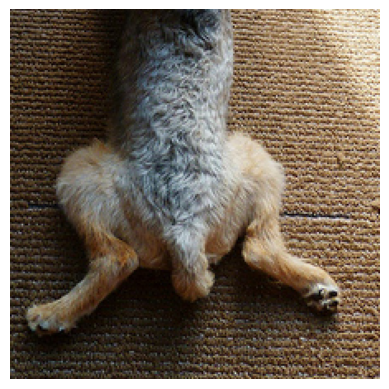

Label: 189
Path: /content/imagenetmini-1000/imagenet-mini/val/n02095570/ILSVRC2012_val_00013640.JPEG


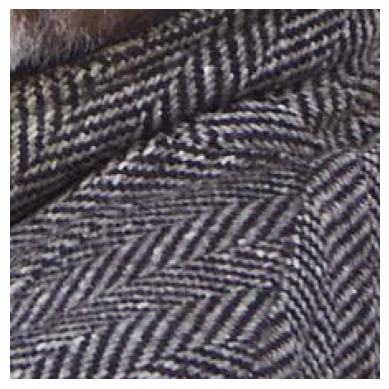

Label: 194
Path: /content/imagenetmini-1000/imagenet-mini/val/n02096437/ILSVRC2012_val_00030910.JPEG


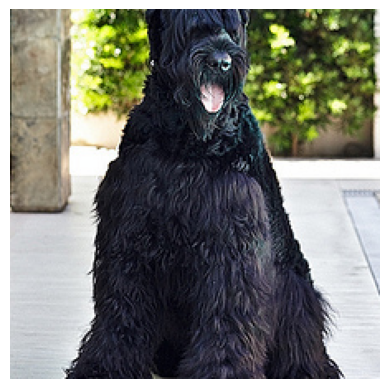

Label: 197
Path: /content/imagenetmini-1000/imagenet-mini/val/n02097130/ILSVRC2012_val_00040836.JPEG


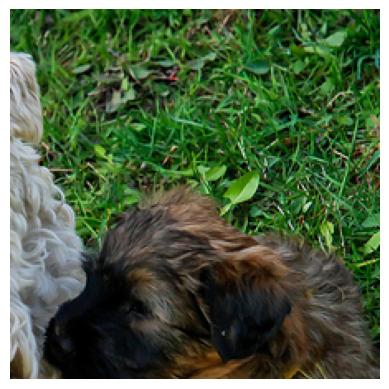

Label: 202
Path: /content/imagenetmini-1000/imagenet-mini/val/n02098105/ILSVRC2012_val_00044461.JPEG


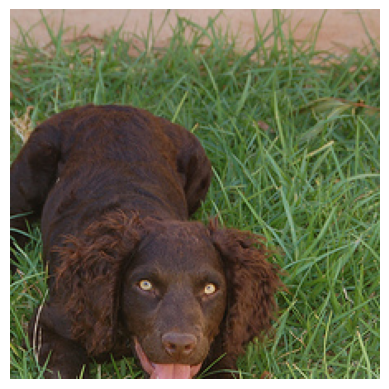

Label: 206
Path: /content/imagenetmini-1000/imagenet-mini/val/n02099429/ILSVRC2012_val_00048141.JPEG


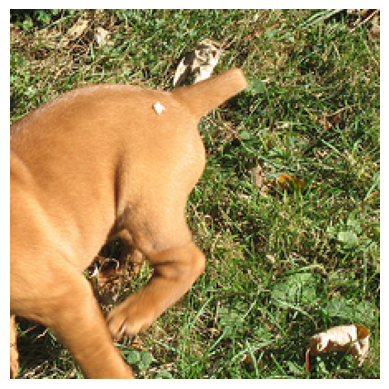

Label: 211
Path: /content/imagenetmini-1000/imagenet-mini/val/n02100583/ILSVRC2012_val_00041472.JPEG


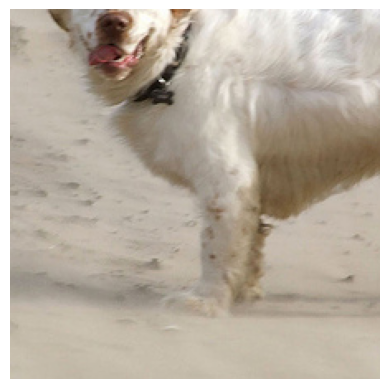

Label: 216
Path: /content/imagenetmini-1000/imagenet-mini/val/n02101556/ILSVRC2012_val_00025549.JPEG


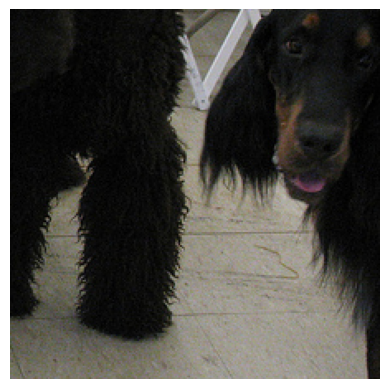

Label: 221
Path: /content/imagenetmini-1000/imagenet-mini/val/n02102973/ILSVRC2012_val_00003628.JPEG


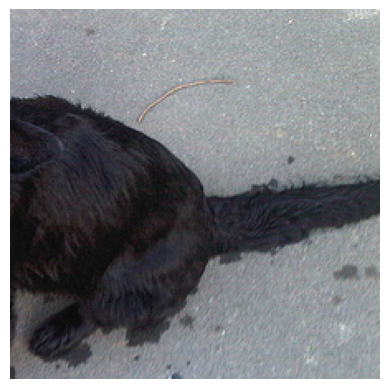

Label: 224
Path: /content/imagenetmini-1000/imagenet-mini/val/n02105056/ILSVRC2012_val_00049815.JPEG


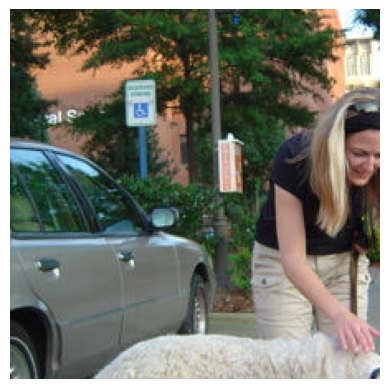

Label: 228
Path: /content/imagenetmini-1000/imagenet-mini/val/n02105505/ILSVRC2012_val_00048075.JPEG


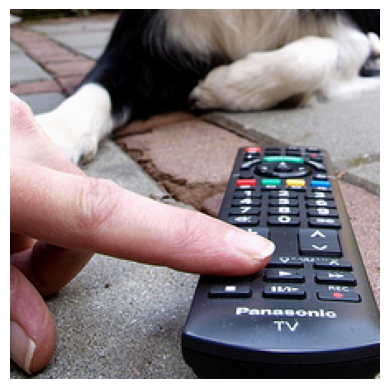

Label: 232
Path: /content/imagenetmini-1000/imagenet-mini/val/n02106166/ILSVRC2012_val_00049942.JPEG


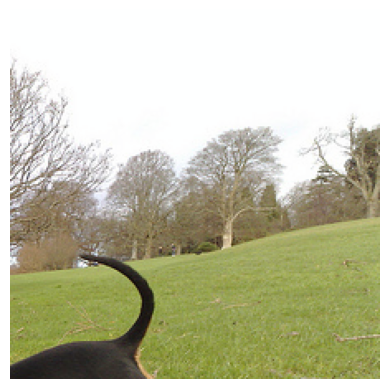

Label: 237
Path: /content/imagenetmini-1000/imagenet-mini/val/n02107312/ILSVRC2012_val_00022240.JPEG


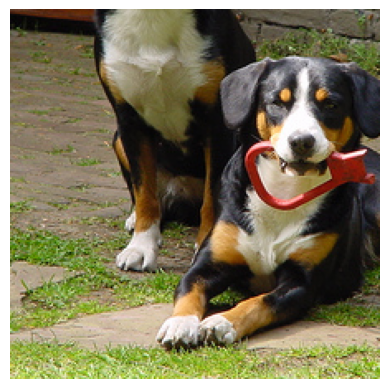

Label: 241
Path: /content/imagenetmini-1000/imagenet-mini/val/n02108000/ILSVRC2012_val_00027751.JPEG


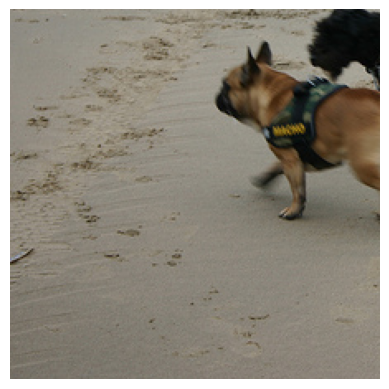

Label: 245
Path: /content/imagenetmini-1000/imagenet-mini/val/n02108915/ILSVRC2012_val_00026283.JPEG


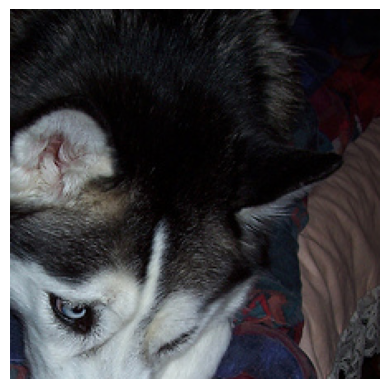

Label: 250
Path: /content/imagenetmini-1000/imagenet-mini/val/n02110185/ILSVRC2012_val_00023615.JPEG


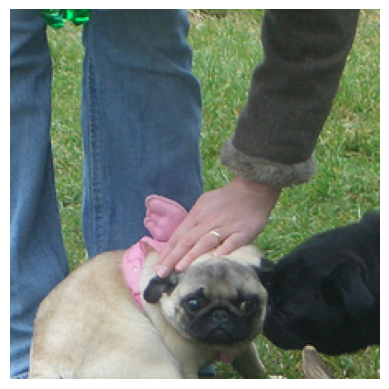

Label: 254
Path: /content/imagenetmini-1000/imagenet-mini/val/n02110958/ILSVRC2012_val_00030606.JPEG


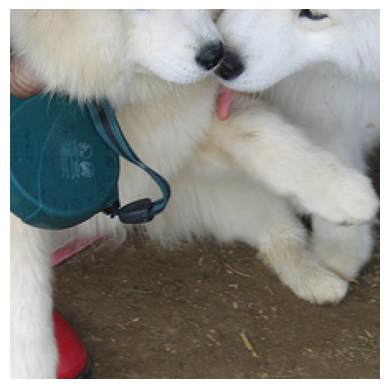

Label: 258
Path: /content/imagenetmini-1000/imagenet-mini/val/n02111889/ILSVRC2012_val_00041820.JPEG


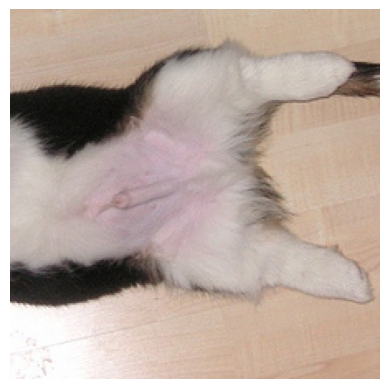

Label: 263
Path: /content/imagenetmini-1000/imagenet-mini/val/n02113023/ILSVRC2012_val_00042776.JPEG


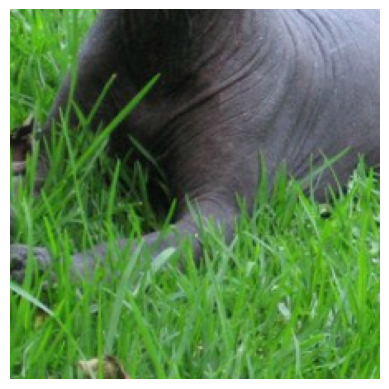

Label: 268
Path: /content/imagenetmini-1000/imagenet-mini/val/n02113978/ILSVRC2012_val_00026509.JPEG


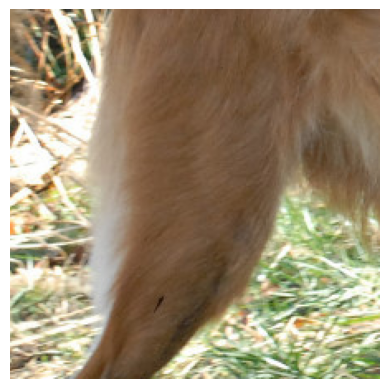

Label: 271
Path: /content/imagenetmini-1000/imagenet-mini/val/n02114712/ILSVRC2012_val_00013985.JPEG


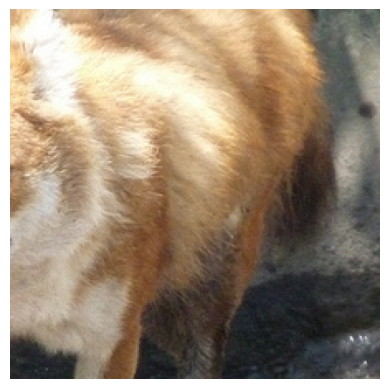

Label: 274
Path: /content/imagenetmini-1000/imagenet-mini/val/n02115913/ILSVRC2012_val_00039608.JPEG


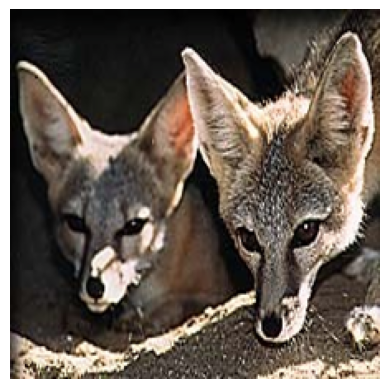

Label: 277
Path: /content/imagenetmini-1000/imagenet-mini/val/n02119022/ILSVRC2012_val_00046388.JPEG


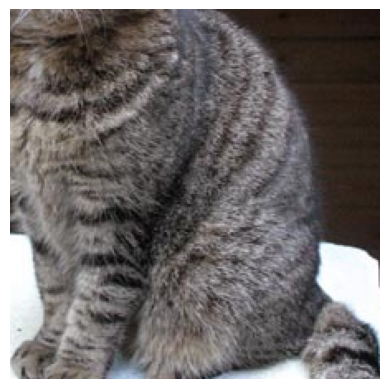

Label: 281
Path: /content/imagenetmini-1000/imagenet-mini/val/n02123045/ILSVRC2012_val_00016389.JPEG


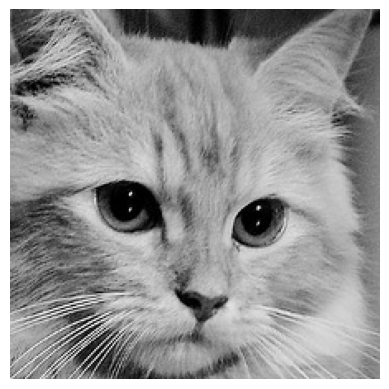

Label: 283
Path: /content/imagenetmini-1000/imagenet-mini/val/n02123394/ILSVRC2012_val_00010218.JPEG


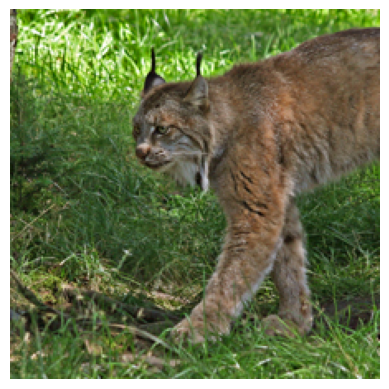

Label: 287
Path: /content/imagenetmini-1000/imagenet-mini/val/n02127052/ILSVRC2012_val_00036244.JPEG


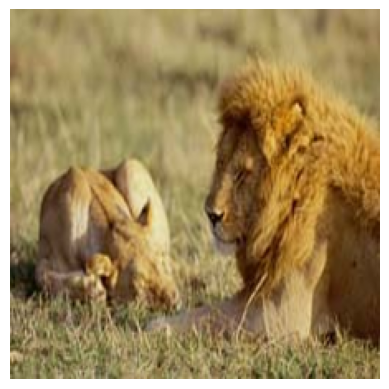

Label: 291
Path: /content/imagenetmini-1000/imagenet-mini/val/n02129165/ILSVRC2012_val_00005410.JPEG


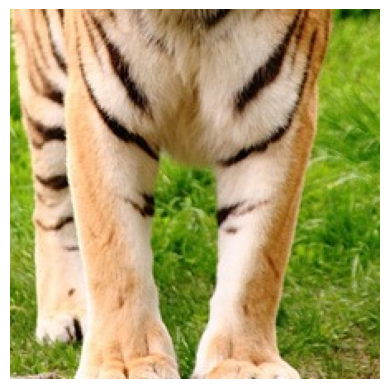

Label: 292
Path: /content/imagenetmini-1000/imagenet-mini/val/n02129604/ILSVRC2012_val_00027576.JPEG


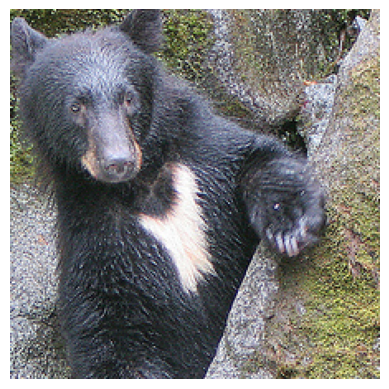

Label: 295
Path: /content/imagenetmini-1000/imagenet-mini/val/n02133161/ILSVRC2012_val_00033969.JPEG


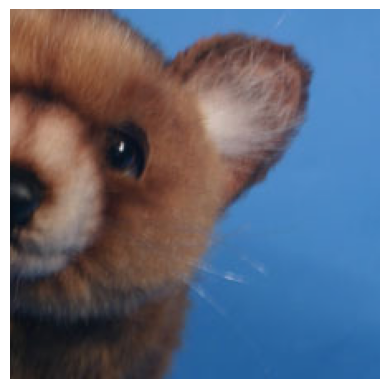

Label: 298
Path: /content/imagenetmini-1000/imagenet-mini/val/n02137549/ILSVRC2012_val_00039800.JPEG


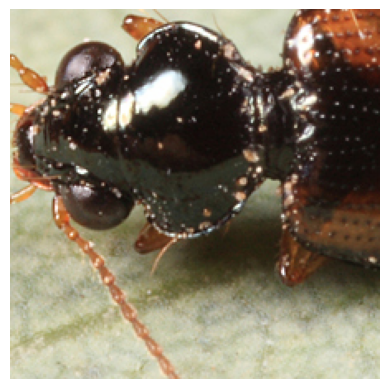

Label: 302
Path: /content/imagenetmini-1000/imagenet-mini/val/n02167151/ILSVRC2012_val_00049611.JPEG


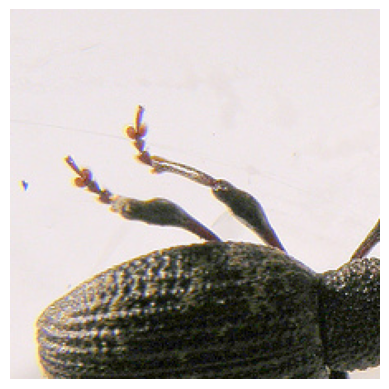

Label: 307
Path: /content/imagenetmini-1000/imagenet-mini/val/n02177972/ILSVRC2012_val_00001570.JPEG


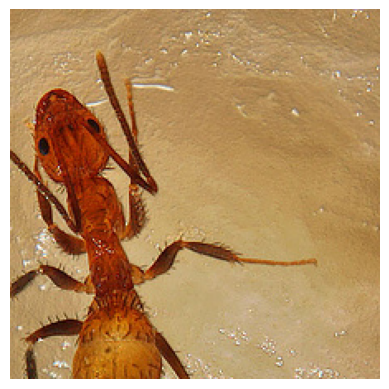

Label: 310
Path: /content/imagenetmini-1000/imagenet-mini/val/n02219486/ILSVRC2012_val_00034370.JPEG


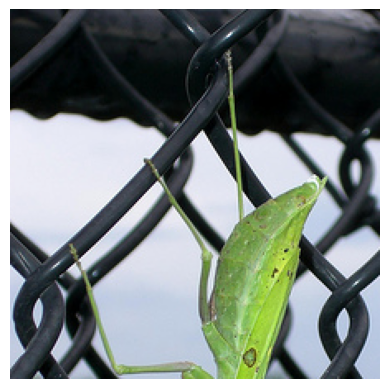

Label: 315
Path: /content/imagenetmini-1000/imagenet-mini/val/n02236044/ILSVRC2012_val_00012127.JPEG


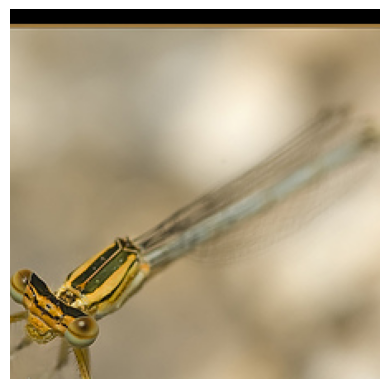

Label: 319
Path: /content/imagenetmini-1000/imagenet-mini/val/n02268443/ILSVRC2012_val_00000418.JPEG


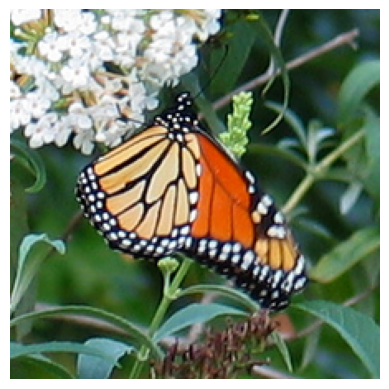

Label: 323
Path: /content/imagenetmini-1000/imagenet-mini/val/n02279972/ILSVRC2012_val_00011143.JPEG


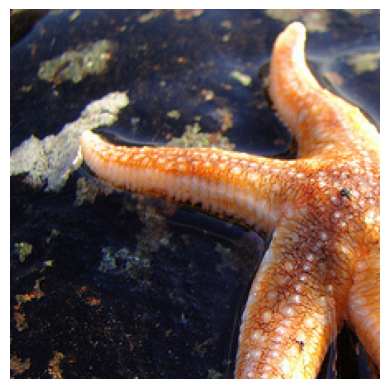

Label: 327
Path: /content/imagenetmini-1000/imagenet-mini/val/n02317335/ILSVRC2012_val_00001161.JPEG


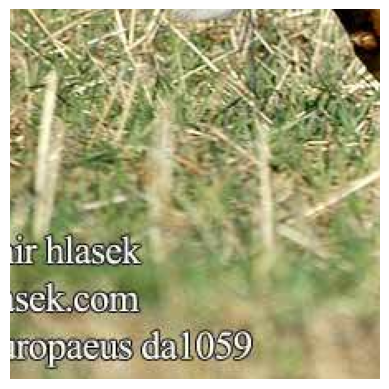

Label: 331
Path: /content/imagenetmini-1000/imagenet-mini/val/n02326432/ILSVRC2012_val_00024176.JPEG


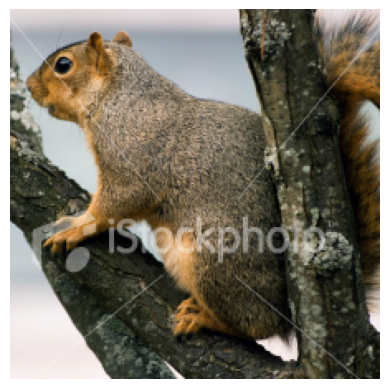

Label: 335
Path: /content/imagenetmini-1000/imagenet-mini/val/n02356798/ILSVRC2012_val_00009363.JPEG


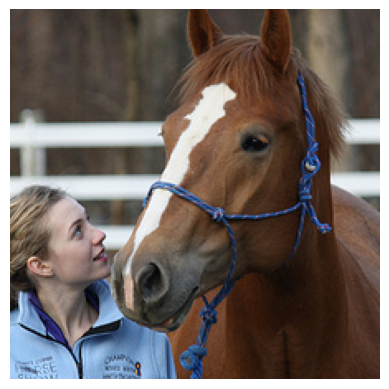

Label: 339
Path: /content/imagenetmini-1000/imagenet-mini/val/n02389026/ILSVRC2012_val_00017532.JPEG


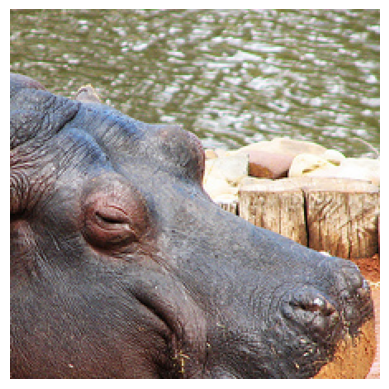

Label: 344
Path: /content/imagenetmini-1000/imagenet-mini/val/n02398521/ILSVRC2012_val_00025996.JPEG


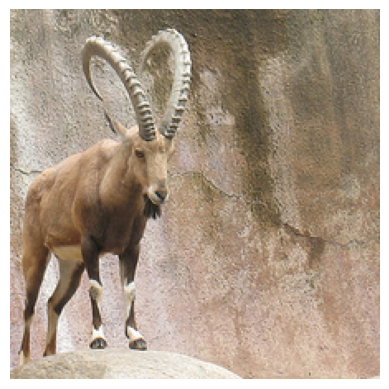

Label: 350
Path: /content/imagenetmini-1000/imagenet-mini/val/n02417914/ILSVRC2012_val_00011977.JPEG


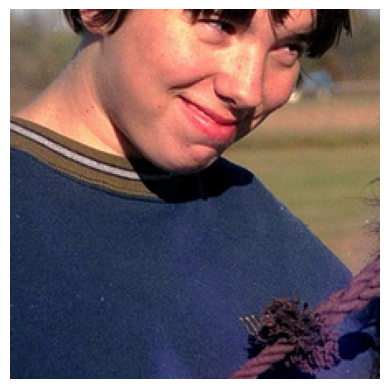

Label: 355
Path: /content/imagenetmini-1000/imagenet-mini/val/n02437616/ILSVRC2012_val_00026223.JPEG


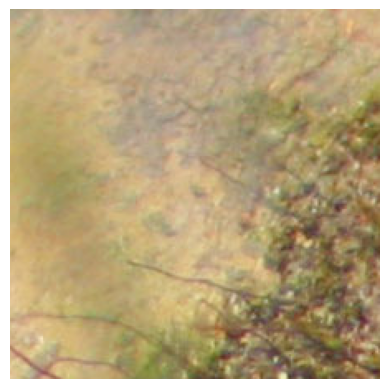

Label: 358
Path: /content/imagenetmini-1000/imagenet-mini/val/n02443114/ILSVRC2012_val_00030791.JPEG


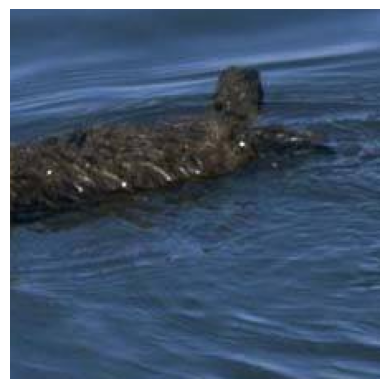

Label: 360
Path: /content/imagenetmini-1000/imagenet-mini/val/n02444819/ILSVRC2012_val_00039520.JPEG


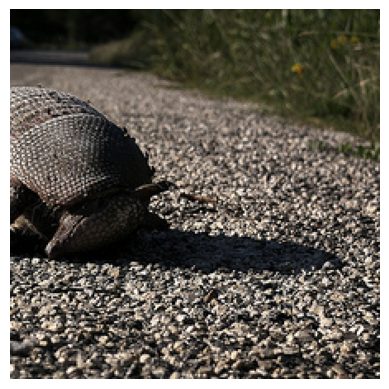

Label: 363
Path: /content/imagenetmini-1000/imagenet-mini/val/n02454379/ILSVRC2012_val_00024257.JPEG


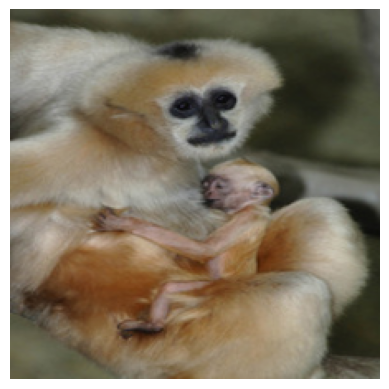

Label: 368
Path: /content/imagenetmini-1000/imagenet-mini/val/n02483362/ILSVRC2012_val_00006256.JPEG


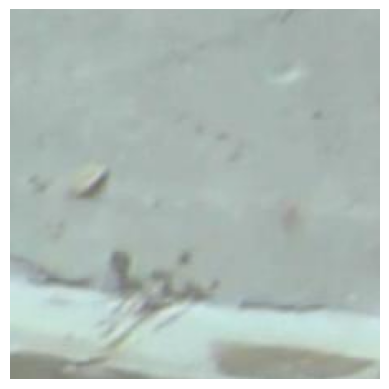

Label: 371
Path: /content/imagenetmini-1000/imagenet-mini/val/n02486261/ILSVRC2012_val_00005969.JPEG


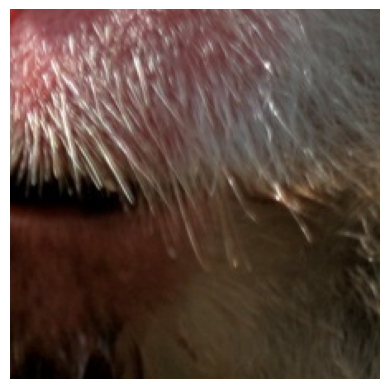

Label: 373
Path: /content/imagenetmini-1000/imagenet-mini/val/n02487347/ILSVRC2012_val_00022040.JPEG


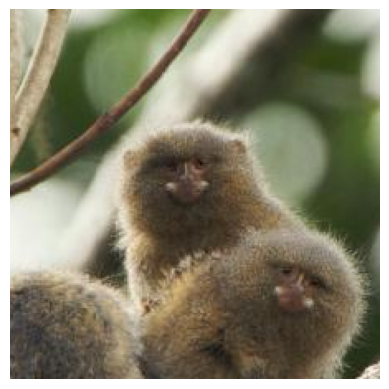

Label: 377
Path: /content/imagenetmini-1000/imagenet-mini/val/n02490219/ILSVRC2012_val_00039866.JPEG


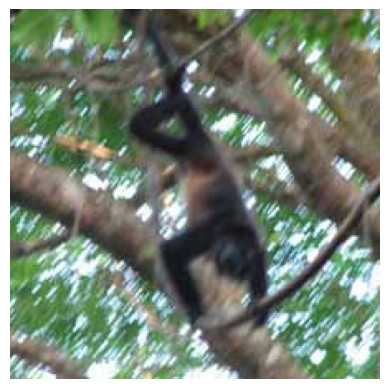

Label: 381
Path: /content/imagenetmini-1000/imagenet-mini/val/n02493793/ILSVRC2012_val_00017507.JPEG


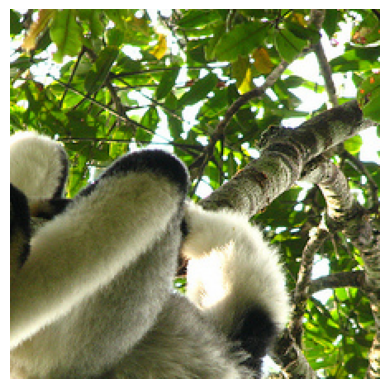

Label: 384
Path: /content/imagenetmini-1000/imagenet-mini/val/n02500267/ILSVRC2012_val_00030022.JPEG


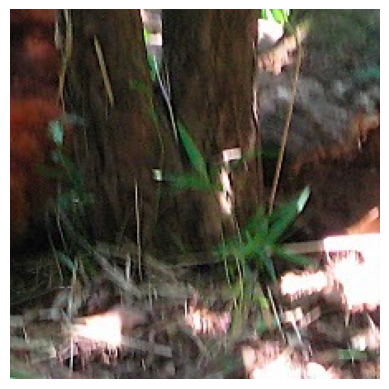

Label: 387
Path: /content/imagenetmini-1000/imagenet-mini/val/n02509815/ILSVRC2012_val_00020033.JPEG


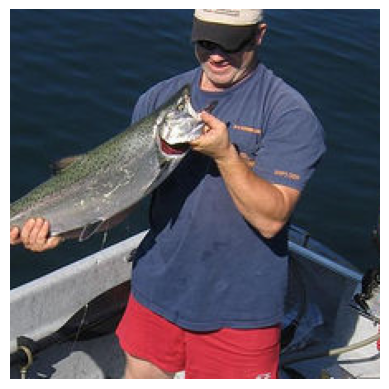

Label: 391
Path: /content/imagenetmini-1000/imagenet-mini/val/n02536864/ILSVRC2012_val_00002721.JPEG


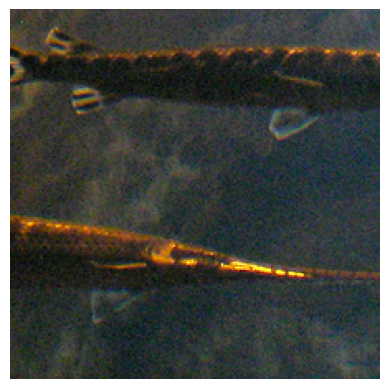

Label: 395
Path: /content/imagenetmini-1000/imagenet-mini/val/n02641379/ILSVRC2012_val_00030098.JPEG


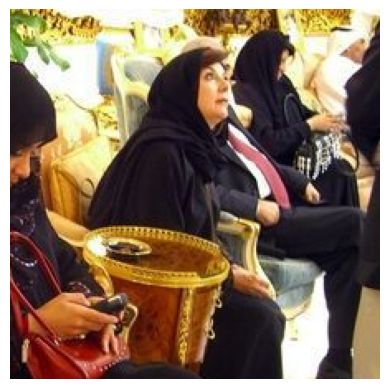

Label: 399
Path: /content/imagenetmini-1000/imagenet-mini/val/n02667093/ILSVRC2012_val_00035215.JPEG


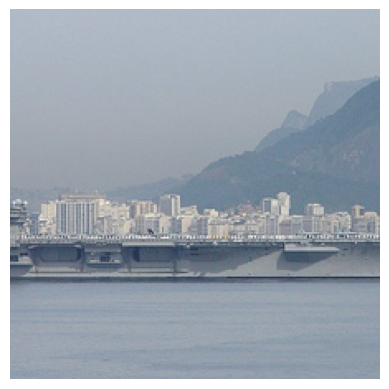

Label: 403
Path: /content/imagenetmini-1000/imagenet-mini/val/n02687172/ILSVRC2012_val_00011995.JPEG


KeyboardInterrupt: 

In [30]:
import matplotlib.pyplot as plt
import numpy as np
import torchvision.transforms as transforms

def imshow(img):
    img = img.numpy().transpose((1, 2, 0))
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    img = std * img + mean
    img = np.clip(img, 0, 1)
    plt.imshow(img)
    plt.axis('off')
    plt.show()
try:
  for images, labels, paths in test_loader_cropped:
      imshow(images[0])
      print("Label:", labels[0].item())
      print("Path:", paths[0])
except Exception as e:
  print(f"An error occurred during image display: {e}")

In [37]:
def run(model, test_loader, text_inputs, class_names):
  all_preds = []
  all_labels = []
  for images, labels, paths in tqdm(test_loader):
      images = images.to(model.device)

      image_inputs = {"pixel_values": images}

      with torch.no_grad():
          image_features = model.get_image_features(**image_inputs)
          text_features = model.get_text_features(**text_inputs)

      image_features = image_features / image_features.norm(p=2, dim=-1, keepdim=True)
      text_features = text_features / text_features.norm(p=2, dim=-1, keepdim=True)

      similarity = torch.matmul(image_features, text_features.T)

      top_probs, top_labels = similarity.softmax(dim=-1).topk(1, dim=-1)

      all_preds.extend(top_labels.squeeze(1).cpu().numpy())
      all_labels.extend(labels.cpu().numpy())
  accuracy = accuracy_score(all_labels, all_preds)
  f1 = f1_score(all_labels, all_preds, average='weighted')
  print(f"Accuracy: {accuracy:.4f}")
  print(f"F1 Score: {f1:.4f}")

In [38]:
run(model, test_loader, text_inputs, class_names)

100%|██████████| 246/246 [04:22<00:00,  1.07s/it]

Accuracy: 0.5669
F1 Score: 0.5506


In [39]:
run(model, test_loader_cropped, text_inputs, class_names)

100%|██████████| 246/246 [04:17<00:00,  1.05s/it]

Accuracy: 0.4678
F1 Score: 0.4544
